In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import torch
from torchvision.transforms import ToTensor, Resize, transforms
import wget
import os
import torch.nn as nn
import torch.optim as optim
import shutil
from PIL import Image
from torchvision.datasets import ImageFolder
import torch.utils.data as data
import numpy as np
import torchvision.utils as vutils

# Загрузка данных

датасет kaggle-
https://www.kaggle.com/datasets/neha1703/movie-genre-from-its-poster/versions/3?resource=download

In [2]:
# df = pd.read_csv('MovieGenre.csv', header=0, encoding="ISO-8859-1")


In [3]:
# df = df.loc[:, ['imdbId', 'Title', 'Genre', 'Poster']]
# df

In [4]:
# pip install wget

Не все ссылки на постеры были корректны, доступны или вообще написаны. поэтому такие фильмы удаляются из датасета.

In [5]:
"""
# IMAGE_FOLDER = "/Users/olgageta/neuroproj"
# if not os.path.exists(IMAGE_FOLDER):
#     os.makedirs(IMAGE_FOLDER)

# rows_to_remove = []

# for idx, row in df.iterrows():
#     url = row['Poster']
#     image_path = os.path.join(IMAGE_FOLDER, str(row['imdbId']) + ".jpg")
    
#     try:
#         wget.download(url, image_path)
#     except:
#         print(f"Error downloading image from {url}")
#         rows_to_remove.append(idx)

# if rows_to_remove:
#     df = df.drop(rows_to_remove)
"""

In [6]:
# df.drop(columns=['Poster'], inplace=True)
# df

In [7]:
# df.to_csv('MoviePoster.csv', index=False)


In [8]:
mov= pd.read_csv('MoviePoster.csv', header=0)
mov

,imdbId,Title,Genre
0,114709,Toy Story (1995),Animation|Adventure|Comedy
1,113497,Jumanji (1995),Action|Adventure|Family
2,113228,Grumpier Old Men (1995),Comedy|Romance
3,114885,Waiting to Exhale (1995),Comedy|Drama|Romance
4,113041,Father of the Bride Part II (1995),Comedy|Family|Romance
...,...,...,...
35702,98216,Roller Blade Warriors: Taken by Force (1989),Action|Adventure|Sci-Fi
35703,83291,Los violadores (1981),Action|Thriller
35704,82875,Pacific Banana (1981),Comedy
35705,815258,Werewolf in a Womens Prison (2006),Horror


In [9]:
mov['Genre'].value_counts()

Drama                        3898
Comedy                       2184
Documentary                  1513
Comedy|Drama                 1365
Drama|Romance                1276
                             ... 
Fantasy|Sci-Fi|Thriller         1
Animation|Fantasy|Musical       1
Comedy|Family|Mystery           1
Adventure|Documentary           1
Documentary|Comedy|Family       1
Name: Genre, Length: 1242, dtype: int64

###### Здесь я планировала удалять с конца фильмы с наименьшими повторениями, но в итоге решила оставить топ-5 жанров

In [12]:
"""
# тут я удаляла с конца по тем где меньше фильмов
# value_counts = mov['Genre'].value_counts()
# unique_values = value_counts[value_counts <= 50].index
# mov = mov[~mov['Genre'].isin(unique_values)]
"""

In [13]:
# mov['Genre'].value_counts()

In [14]:
top_5_values = mov['Genre'].value_counts().nlargest(5).index
top_5_values

Index(['Drama', 'Comedy', 'Documentary', 'Comedy|Drama', 'Drama|Romance'], dtype='object')

In [15]:
data = mov[mov['Genre'].isin(top_5_values)]

In [16]:
data

,imdbId,Title,Genre
6,114319,Sabrina (1995),Comedy|Drama
14,114388,Sense and Sensibility (1995),Drama|Romance
15,113101,Four Rooms (1995),Comedy
22,113627,Leaving Las Vegas (1995),Drama|Romance
24,114117,Persuasion,Drama
...,...,...,...
35685,1337139,45365 (2009),Documentary
35689,5946232,Russell Peters: Almost Famous (2016),Comedy
35692,5957584,Girl in the Box (2016),Drama
35698,4882174,37 (2016),Drama


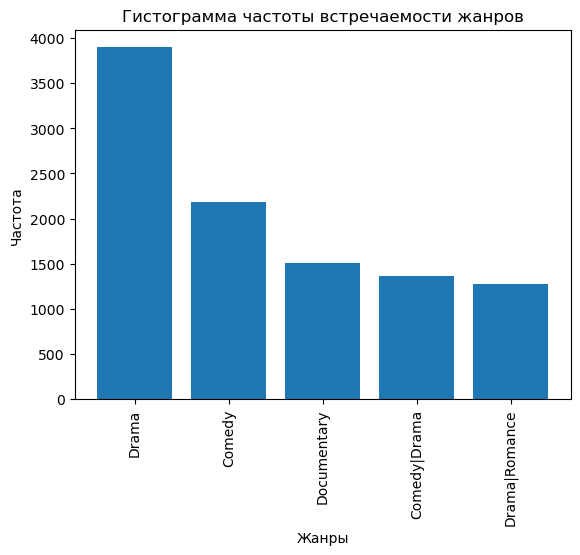

In [17]:
value_counts = data['Genre'].value_counts()


plt.bar(value_counts.index, value_counts.values)

plt.xlabel('Жанры')
plt.ylabel('Частота')
plt.title('Гистограмма частоты встречаемости жанров')
plt.xticks(rotation='vertical')


plt.show()

In [18]:
data['Genre'].value_counts()

Drama            3898
Comedy           2184
Documentary      1513
Comedy|Drama     1365
Drama|Romance    1276
Name: Genre, dtype: int64

###### Для планов добавления условной модели разбивала постеры в подпапки по жанрам

In [19]:
"""
# Пути к папкам
# source_folder = "../neuroproj"
# target_folder = "proj"

# Создание подпапок в целевой папке на основе уникальных значений в столбце 'Genre'
# unique_genres = data['Genre'].unique()
# for genre in unique_genres:
#     genre_folder = os.path.join(target_folder, genre)
#     os.makedirs(genre_folder, exist_ok=True)

# Копирование изображений в соответствующие подпапки
# for index, row in data.iterrows():
#     imdb_id = row['imdbId']
#     genre = row['Genre']
#     poster_filename = str(imdb_id) + ".jpg"
    
#     source_path = os.path.join(source_folder, poster_filename)
#     target_path = os.path.join(target_folder, genre, poster_filename)
    
#     if os.path.isfile(source_path):
#         shutil.copy(source_path, target_path)
#         print(f"Копирование изображения {poster_filename} в папку {genre} завершено.")
#     else:
#         print(f"Изображение {poster_filename} не найдено в папке {source_folder}. Пропуск.")
"""

###### Проверяю размеры изображений

In [20]:
from PIL import Image
import os

folder_path = "proj" 

# Множество для хранения уникальных размеров изображений
unique_sizes = set()

# Перебор подпапок и загрузка изображений
for subfolder in os.listdir(folder_path):
    subfolder_path = os.path.join(folder_path, subfolder)
    if os.path.isdir(subfolder_path):
        image_files = [f for f in os.listdir(subfolder_path) if os.path.isfile(os.path.join(subfolder_path, f)) and f.endswith(('.jpg', '.jpeg', '.png'))]
        
        # Загрузка и обработка каждого изображения
        for image_file in image_files:
            image_path = os.path.join(subfolder_path, image_file)
            image = Image.open(image_path)

            unique_sizes.add(image.size)

if len(unique_sizes) == 1:
    print("Все изображения имеют одинаковый размер.")
else:
    print("Изображения имеют разные размеры.")

print("Уникальные размеры изображений:")
for size in unique_sizes:
    print(size)

print("Количество просмотренных изображений:", sum(len(files) for _, _, files in os.walk(folder_path)))


Все изображения имеют одинаковый размер.
Уникальные размеры изображений:
(182, 268)
Количество просмотренных изображений: 10092


###### Добавляю к таблице столбец с путем к постерам

In [21]:
image_folder = "proj" 

data['Image'] = data['imdbId'].astype(str) + '.jpg'

def find_image_path(row):
    for genre_folder in os.listdir(image_folder):
        genre_path = os.path.join(image_folder, genre_folder)
        if os.path.isfile(os.path.join(genre_path, row['Image'])):
            return os.path.join(genre_path, row['Image'])
    return None

data['Image'] = data.apply(find_image_path, axis=1)
data


/var/folders/rs/fkk70l394gz79cxj0sdr_spc0000gn/T/ipykernel_16715/1662082563.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Image'] = data['imdbId'].astype(str) + '.jpg'
/var/folders/rs/fkk70l394gz79cxj0sdr_spc0000gn/T/ipykernel_16715/1662082563.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['Image'] = data.apply(find_image_path, axis=1)


,imdbId,Title,Genre,Image
6,114319,Sabrina (1995),Comedy|Drama,proj/Comedy|Drama/114319.jpg
14,114388,Sense and Sensibility (1995),Drama|Romance,proj/Drama|Romance/114388.jpg
15,113101,Four Rooms (1995),Comedy,proj/Comedy/113101.jpg
22,113627,Leaving Las Vegas (1995),Drama|Romance,proj/Drama|Romance/113627.jpg
24,114117,Persuasion,Drama,proj/Drama/114117.jpg
...,...,...,...,...
35685,1337139,45365 (2009),Documentary,proj/Documentary/1337139.jpg
35689,5946232,Russell Peters: Almost Famous (2016),Comedy,proj/Comedy/5946232.jpg
35692,5957584,Girl in the Box (2016),Drama,proj/Drama/5957584.jpg
35698,4882174,37 (2016),Drama,proj/Drama/4882174.jpg


###### Создание вектора жанров. В итоге в своей модели не использовала

In [22]:
genre_labels = {'Drama': 0, 'Comedy': 1, 'Documentary': 2, 'Comedy|Drama': 3, 'Drama|Romance': 4}
data['genre_label'] = data['Genre'].map(genre_labels)


/var/folders/rs/fkk70l394gz79cxj0sdr_spc0000gn/T/ipykernel_16715/3574514580.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['genre_label'] = data['Genre'].map(genre_labels)


In [23]:
data


,imdbId,Title,Genre,Image,genre_label
6,114319,Sabrina (1995),Comedy|Drama,proj/Comedy|Drama/114319.jpg,3
14,114388,Sense and Sensibility (1995),Drama|Romance,proj/Drama|Romance/114388.jpg,4
15,113101,Four Rooms (1995),Comedy,proj/Comedy/113101.jpg,1
22,113627,Leaving Las Vegas (1995),Drama|Romance,proj/Drama|Romance/113627.jpg,4
24,114117,Persuasion,Drama,proj/Drama/114117.jpg,0
...,...,...,...,...,...
35685,1337139,45365 (2009),Documentary,proj/Documentary/1337139.jpg,2
35689,5946232,Russell Peters: Almost Famous (2016),Comedy,proj/Comedy/5946232.jpg,1
35692,5957584,Girl in the Box (2016),Drama,proj/Drama/5957584.jpg,0
35698,4882174,37 (2016),Drama,proj/Drama/4882174.jpg,0


###### inputs для сетки

In [26]:
# Root directory for dataset 
dataroot = "./proj/"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 32

# Spatial size of training images.
image_size = 64

# Number of channels in the training images.
nc = 3

# Size of z latent vector
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 30

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

###### Dataloader

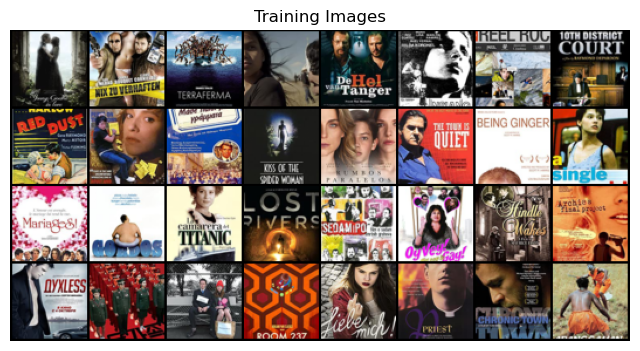

In [27]:
root = "proj"


transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])


dataset = ImageFolder(root=root, transform=transform)
dataloader = data.DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=workers)

# Визуализация некоторых изображений из датасета
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")
real_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(
    np.transpose(
        vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),
        (1, 2, 0)
    )
)
plt.show()


In [28]:
print("Number of images in the dataloader:", len(dataset))

Number of images in the dataloader: 10092


###### Функция для инициализации весов модели

In [29]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [30]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # Входной слой: Z, проходящий через свертку
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh())

    def forward(self, input):
        return self.main(input)


In [31]:
# генератор
netG = Generator(ngpu).to(device)

if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Применение функции weights_init для случайной инициализации всех весов
netG.apply(weights_init)

print(netG)


Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [32]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # Входной слой: (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Flatten(1),
            nn.Sigmoid())
            #nn.MaxPool2d(opt.imageSize // 64))

    def forward(self, input):
        return self.main(input)


In [33]:
netD = Discriminator(ngpu).to(device)

if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Применение функции weights_init для случайной инициализации всех весов
netD.apply(weights_init)

print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Flatten(start_dim=1, end_dim=-1)
    (13): Sig

In [34]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.0
fake_label = 0.0

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))


In [35]:
# Training 
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):

        netD.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = netD(real_cpu).view(-1)
        #print(output.shape)
        #print(label.shape)
        #print("1")
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()
    

        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()

        netG.zero_grad()
        label.fill_(real_label)
        output = netD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        G_losses.append(errG.item())
        D_losses.append(errD.item())

        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1


Starting Training Loop...


[W NNPACK.cpp:51] Could not initialize NNPACK! Reason: Unsupported hardware.


[0/30][0/316]	Loss_D: 2.3077	Loss_G: 4.4620	D(x): 0.2855	D(G(z)): 0.4460 / 0.0125
[0/30][50/316]	Loss_D: 0.1929	Loss_G: 20.9252	D(x): 0.8531	D(G(z)): 0.0000 / 0.0000
[0/30][100/316]	Loss_D: 1.0280	Loss_G: 4.9051	D(x): 0.7225	D(G(z)): 0.3370 / 0.0163
[0/30][150/316]	Loss_D: 0.6098	Loss_G: 6.4915	D(x): 0.7198	D(G(z)): 0.1712 / 0.0019
[0/30][200/316]	Loss_D: 1.4099	Loss_G: 12.4025	D(x): 0.8571	D(G(z)): 0.5225 / 0.0000
[0/30][250/316]	Loss_D: 0.0549	Loss_G: 7.4772	D(x): 0.9572	D(G(z)): 0.0098 / 0.0014
[0/30][300/316]	Loss_D: 0.3026	Loss_G: 6.5547	D(x): 0.8196	D(G(z)): 0.0054 / 0.0062
[1/30][0/316]	Loss_D: 0.9114	Loss_G: 8.2475	D(x): 0.8072	D(G(z)): 0.3046 / 0.0005
[1/30][50/316]	Loss_D: 2.2739	Loss_G: 2.5242	D(x): 0.2109	D(G(z)): 0.0070 / 0.1628
[1/30][100/316]	Loss_D: 0.8963	Loss_G: 4.1496	D(x): 0.7196	D(G(z)): 0.2751 / 0.0441
[1/30][150/316]	Loss_D: 0.3850	Loss_G: 6.1399	D(x): 0.9065	D(G(z)): 0.2193 / 0.0029
[1/30][200/316]	Loss_D: 0.3222	Loss_G: 6.5048	D(x): 0.9344	D(G(z)): 0.1992 / 0.0

[14/30][0/316]	Loss_D: 0.5067	Loss_G: 5.2220	D(x): 0.9705	D(G(z)): 0.2783 / 0.0087
[14/30][50/316]	Loss_D: 0.6353	Loss_G: 6.9354	D(x): 0.9096	D(G(z)): 0.3531 / 0.0014
[14/30][100/316]	Loss_D: 0.1594	Loss_G: 4.7429	D(x): 0.8979	D(G(z)): 0.0385 / 0.0182
[14/30][150/316]	Loss_D: 0.3221	Loss_G: 5.7808	D(x): 0.9787	D(G(z)): 0.1809 / 0.0081
[14/30][200/316]	Loss_D: 0.3130	Loss_G: 4.4955	D(x): 0.9232	D(G(z)): 0.1822 / 0.0165
[14/30][250/316]	Loss_D: 0.1866	Loss_G: 4.2643	D(x): 0.8970	D(G(z)): 0.0637 / 0.0391
[14/30][300/316]	Loss_D: 0.3938	Loss_G: 4.1053	D(x): 0.9226	D(G(z)): 0.2326 / 0.0212
[15/30][0/316]	Loss_D: 0.2483	Loss_G: 4.6162	D(x): 0.9232	D(G(z)): 0.1415 / 0.0137
[15/30][50/316]	Loss_D: 0.7247	Loss_G: 5.4494	D(x): 0.8128	D(G(z)): 0.3505 / 0.0068
[15/30][100/316]	Loss_D: 0.2806	Loss_G: 5.3698	D(x): 0.7884	D(G(z)): 0.0155 / 0.0098
[15/30][150/316]	Loss_D: 1.0803	Loss_G: 10.0592	D(x): 0.9909	D(G(z)): 0.6196 / 0.0001
[15/30][200/316]	Loss_D: 0.2510	Loss_G: 3.7154	D(x): 0.8460	D(G(z)): 0

[27/30][300/316]	Loss_D: 0.0925	Loss_G: 5.5506	D(x): 0.9220	D(G(z)): 0.0057 / 0.0097
[28/30][0/316]	Loss_D: 0.2560	Loss_G: 6.2884	D(x): 0.9825	D(G(z)): 0.1858 / 0.0035
[28/30][50/316]	Loss_D: 0.1753	Loss_G: 4.5387	D(x): 0.8729	D(G(z)): 0.0316 / 0.0180
[28/30][100/316]	Loss_D: 0.2485	Loss_G: 4.4976	D(x): 0.8043	D(G(z)): 0.0092 / 0.0188
[28/30][150/316]	Loss_D: 0.0818	Loss_G: 5.0499	D(x): 0.9836	D(G(z)): 0.0601 / 0.0100
[28/30][200/316]	Loss_D: 0.4927	Loss_G: 5.7695	D(x): 0.6568	D(G(z)): 0.0018 / 0.0075
[28/30][250/316]	Loss_D: 0.4503	Loss_G: 3.8728	D(x): 0.6923	D(G(z)): 0.0180 / 0.0416
[28/30][300/316]	Loss_D: 0.2453	Loss_G: 4.2045	D(x): 0.9765	D(G(z)): 0.1779 / 0.0196
[29/30][0/316]	Loss_D: 0.6281	Loss_G: 5.4368	D(x): 0.6017	D(G(z)): 0.0009 / 0.0112
[29/30][50/316]	Loss_D: 0.5511	Loss_G: 2.1370	D(x): 0.6644	D(G(z)): 0.0178 / 0.2048
[29/30][100/316]	Loss_D: 0.0783	Loss_G: 5.0741	D(x): 0.9833	D(G(z)): 0.0581 / 0.0094
[29/30][150/316]	Loss_D: 0.1228	Loss_G: 4.7258	D(x): 0.9859	D(G(z)): 0.

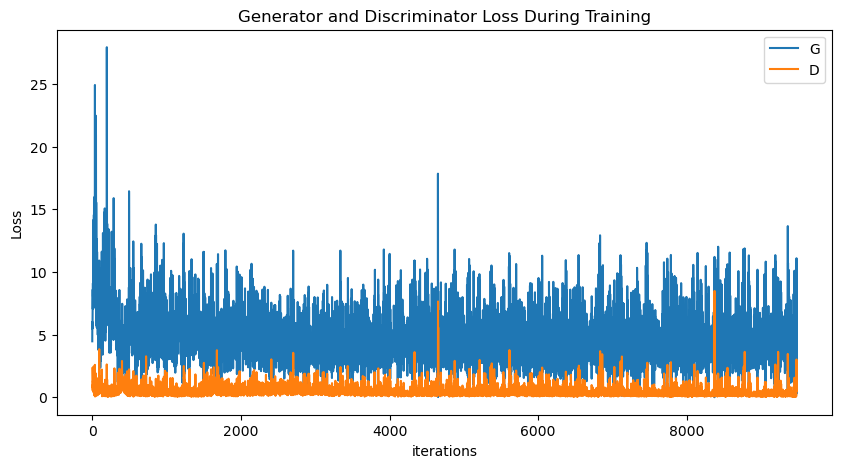

In [43]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21332838 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


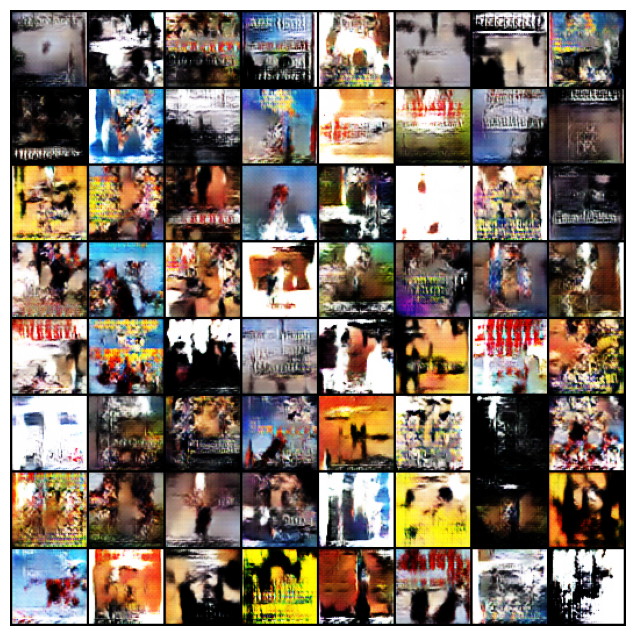

In [44]:
import matplotlib.animation as animation
from IPython.display import HTML
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [ ]:
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()